In [1]:
import matplotlib.pyplot as plt
import sys
sys.path.append('../')
import src.trainers as tr
import src.read_pic as rp
import os
# Fields to read.
fields_to_read={"B":True,"B_ext":False,"divB":True,"E":True,"E_ext":False,"rho":True,"J":True,
                "P":True,"PI":False,"Heat_flux":False,"N":False,"Qrem":False}
# Path of the folder containing the .h5 files to read.
files_path="/volume1/scratch/share_dir/ecsim/peppe/" #"/lustre1/project/stg_00032/share_dir/brecht/" # "/users/cpa/francesc/share_dir/SW/data_small/" #"/users/cpa/francesc/share_dir/jincai/dat_FF2D07e/" #="/users/cpa/francesc/share_dir/nn/data/raw_data/"
experiments = [f.name for f in os.scandir(files_path) if f.is_dir()]
print(f"{experiments = }")

experiments = ['T2D13_ftr2_shift', 'data', 'T2D17_filter2', 'T2D10c1_filter2', 'T2D12_filter2', 'T2D10', 'T2D12', 'T2D10_filter2', 'data_filter', 'T2D19_filter2', 'T2D13_filter2', 'T2D15_filter2', 'data_filter2', 'Smooth13_filter2', 'T2D16_filter2', 'T2D14_filter2', 'T2D18_filter2']


In [2]:
experiment = 'data'

In [3]:
data, X, Y, qom, times = rp.get_exp_times([experiment], files_path, fields_to_read, choose_species=['e','i'], verbose=True)

INFO:src.read_pic: reading /volume1/scratch/share_dir/ecsim/peppe//data/SimulationData.txt
INFO:src.read_pic:Lx = 64.0, Ly = 64.0, nxc = 2048, nyc = 2048
INFO:src.read_pic:loading B
INFO:src.read_pic:loading E
INFO:src.read_pic:loading divB
INFO:src.read_pic:loading rho
INFO:src.read_pic:loading J
INFO:src.read_pic:loading P and/or PI
INFO:src.read_pic:Component Pyx for species e missing because tensor is symmetric
INFO:src.read_pic:Component Pyx for species i missing because tensor is symmetric
INFO:src.read_pic:Component Pzx for species e missing because tensor is symmetric
INFO:src.read_pic:Component Pzx for species i missing because tensor is symmetric
INFO:src.read_pic:Component Pzy for species e missing because tensor is symmetric
INFO:src.read_pic:Component Pzy for species i missing because tensor is symmetric
INFO:src.read_pic:loading Ppar and Pperp
INFO:src.read_pic:loading Ppar and Pperp
INFO:src.read_pic:choose_x = [0, 2048], choose_y = [0, 2048], choose_z = [0, 1], choose_t

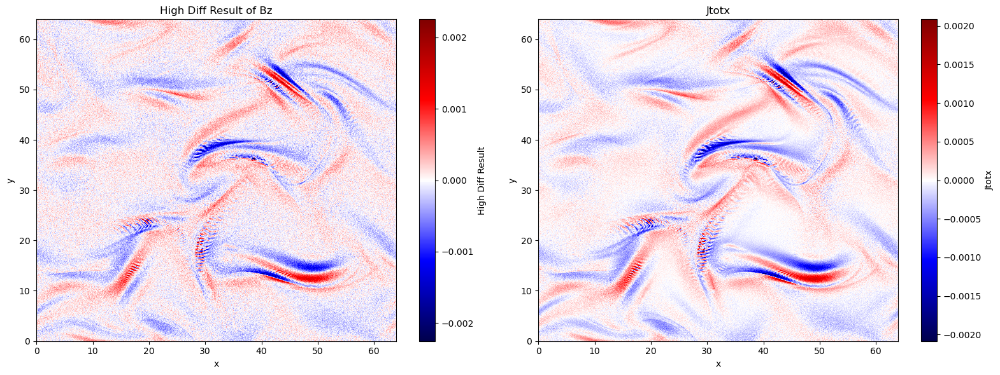

In [5]:
import numpy as np
import src.utilities as ut
i = 5
dat = data[experiment]
# Calculate highdiff result
dx = np.abs(X[1, 0] - X[1, 0])
dy = np.abs(Y[0, 1] - Y[0, 0])
result = ut.highdiff(dat['Bz'], dx, dy, axis=1, mode='wrap')/(4*np.pi)

# Create subplots
fig, axs = plt.subplots(1, 2, figsize=(16, 6))

# Plot highdiff result
im1 = axs[0].pcolormesh(X, Y, result[..., i], cmap='seismic', shading='auto', vmax=result[..., i].max(), vmin=-result[..., i].max())
fig.colorbar(im1, ax=axs[0], label='High Diff Result')
axs[0].set_title('High Diff Result of Bz')
axs[0].set_xlabel('x')
axs[0].set_ylabel('y')

# Plot data['Jtotx']
im2 = axs[1].pcolormesh(X, Y, dat['Jtotx'][..., i], cmap='seismic', shading='auto', vmax=dat['Jtotx'][..., i].max(), vmin=-dat['Jtotx'][..., i].max())
fig.colorbar(im2, ax=axs[1], label='Jtotx')
axs[1].set_title('Jtotx')
axs[1].set_xlabel('x')
axs[1].set_ylabel('y')

plt.tight_layout()
plt.show()

In [6]:
import numpy as np
import matplotlib.animation as animation
# Create a figure and axis
fig, ax = plt.subplots()
data[experiment]['Jz_tot'] = data[experiment]['Jz']['e'] + data[experiment]['Jz']['i']
# Find the min and max values for Jz to set vmin and vmax
Jz_min = min(np.min(data[experiment]['Jz_tot']), np.min(data[experiment]['Jz_tot']))
Jz_max = max(np.max(data[experiment]['Jz_tot']), np.max(data[experiment]['Jz_tot']))
vlimit = max(-Jz_min, Jz_max)

# Initialize the plot with the first frame
cax = ax.imshow(data[experiment]['Jz_tot'][:, :, 0], vmin=-vlimit/2, vmax=vlimit/2, cmap='seismic')
fig.colorbar(cax)

def update(frame):
    cax.set_data(data[experiment]['Jz_tot'][:, :, frame])
    return cax,

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=data[experiment]['Jz_tot'].shape[2], blit=True)

# Save the animation as a gif file
ani.save(f'peppe.gif', writer='imagemagick')

plt.close(fig)

INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.PillowWriter'>


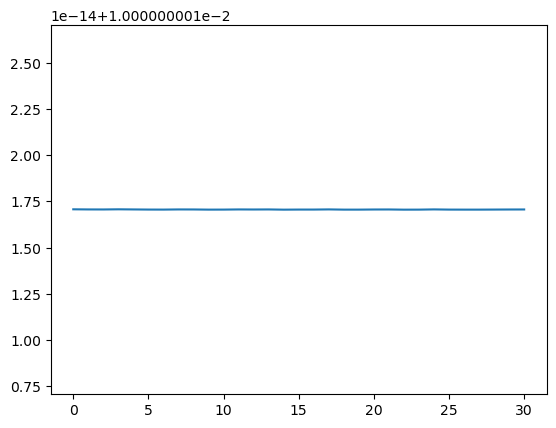

In [6]:
import matplotlib.pyplot as plt
import numpy as np
plt.plot([np.mean(data[experiment]['Bz'][...,i]) for i in range(data[experiment]['Bz'].shape[-1])])

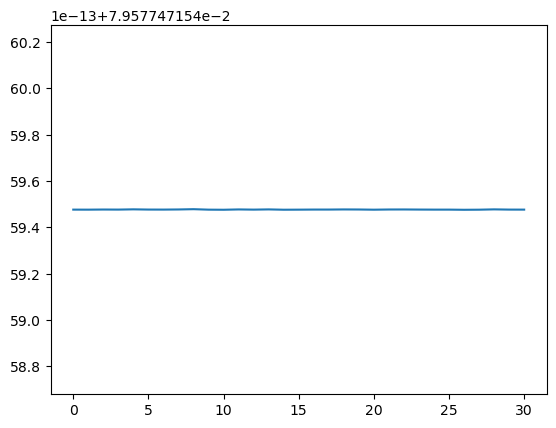

In [7]:
import matplotlib.pyplot as plt
import numpy as np
plt.plot([np.mean(data[experiment]['rho']['i'][...,i]) for i in range(data[experiment]['rho']['i'].shape[-1])])

In [10]:
1/(4*np.pi)

0.07957747154594767

In [9]:
np.mean(data[experiment]['rho']['i'][...,0])

0.07957747154594763

In [11]:
np.mean(data[experiment]['Bz'][...,0])

0.010000000011317076

In [12]:
import numpy as np
i = 0
print((np.mean((data[experiment]['Pxx']['i'][...,i]+data[experiment]['Pyy']['i'][...,i]+data[experiment]['Pzz']['i'][...,i])/3))/(np.mean(data[experiment]['Bz'][...,i]**2)/(8*np.pi)))
print((np.mean((data[experiment]['Pxx']['e'][...,i]+data[experiment]['Pyy']['e'][...,i]+data[experiment]['Pzz']['e'][...,i])/3))/(np.mean(data[experiment]['Bz'][...,0]**2)/(8*np.pi)))

7.773756565463495
1.9434251665369782


In [14]:
import numpy as np
i = 20
print((np.mean((data[experiment]['Pxx']['i'][...,i]+data[experiment]['Pyy']['i'][...,i]+data[experiment]['Pzz']['i'][...,i])/3))/(np.mean(data[experiment]['Bz'][...,i]**2)/(8*np.pi)))
print((np.mean((data[experiment]['Pxx']['e'][...,i]+data[experiment]['Pyy']['e'][...,i]+data[experiment]['Pzz']['e'][...,i])/3))/(np.mean(data[experiment]['Bz'][...,0]**2)/(8*np.pi)))

7.674732510521155
2.455949645530345


## Electrons

In [ ]:
data, X, Y, qom, times = rp.get_exp_times(experiments, files_path, fields_to_read, choose_species=['e',None], verbose=True)

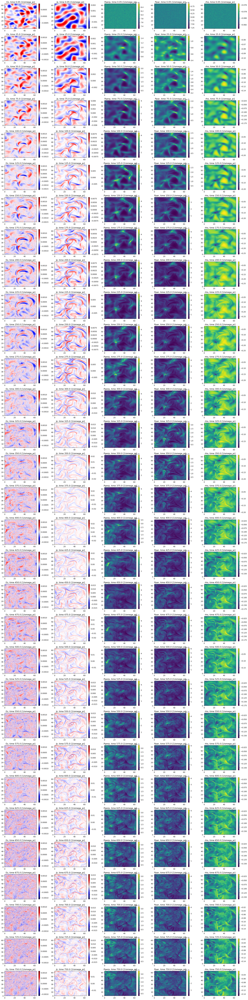

In [7]:
import matplotlib.pyplot as plt
#times = data[experiment]['Bx'].shape[2]
fig, axes = plt.subplots(len(times), 5, figsize=(20, 80))
for i, time in enumerate(times):
    for j, field in enumerate(['Ez', 'Jz', 'Pperp', 'Ppar', 'rho']):
        cmap = 'seismic' if field == 'Ez' or field == 'Jz' else 'viridis'
        vmin, vmax = None, None
        if field == 'Jz':
            vmax = max([data[experiment][field]['e'][...,i].max(), -data[experiment][field]['e'][...,i].min()])
            vmin = -vmax
        if field == 'Ez':
            vmax = max([data[experiment][field][...,i].max(), -data[experiment][field][...,i].min()])
            vmin = -vmax
            im = axes[i,j].pcolormesh(X, Y, data[experiment]['Ez'][...,i],cmap=cmap,vmax=vmax,vmin=vmin)
        else:
            im = axes[i,j].pcolormesh(X, Y, data[experiment][field]['e'][...,i], cmap=cmap, vmax=vmax, vmin=vmin)
        axes[i,j].set_title(f"{field}, time {time} [1/omega_pi]")
        fig.colorbar(im,ax=axes[i,j])
plt.tight_layout()
plt.show()


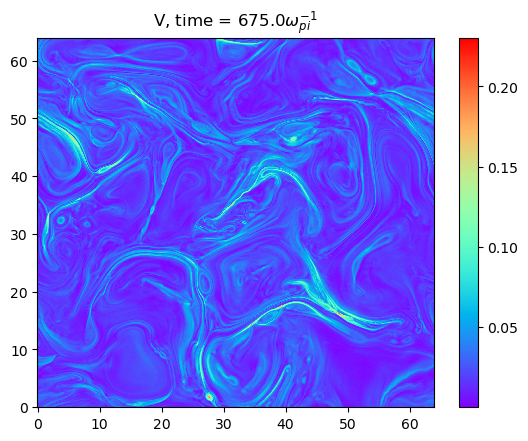

In [5]:
import numpy as  np
i = 27
plt.pcolormesh(X, Y, np.sqrt(data[experiment]['Vx']['e'][...,i]**2+data[experiment]['Vy']['e'][...,i]**2+data[experiment]['Vz']['e'][...,i]**2), cmap='rainbow')
plt.colorbar()
plt.title(f"V, time = {times[i]}"+r"$\omega_{pi}^{-1}$")
plt.show()

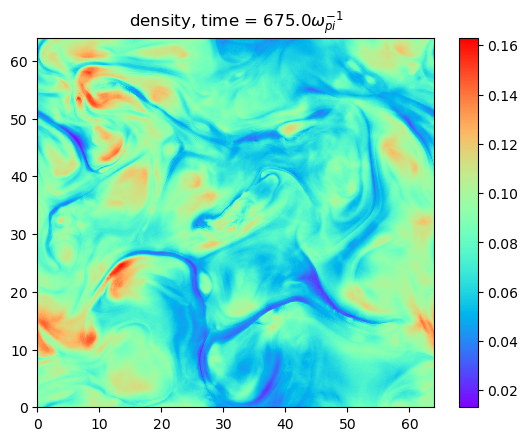

In [22]:
import numpy as  np
i = 27
plt.pcolormesh(X, Y, -data[experiment]['rho']['e'][...,i], cmap='rainbow')
plt.colorbar()
plt.title(f"density, time = {times[i]}"+r"$\omega_{pi}^{-1}$")
plt.show()

## Ions

In [3]:
data, X, Y, qom, times = rp.get_exp_times(experiments, files_path, fields_to_read, choose_species=[None,'i'], verbose=True)

INFO:src.read_pic:loading B
INFO:src.read_pic:loading E
INFO:src.read_pic:loading divB
INFO:src.read_pic:loading rho
INFO:src.read_pic:loading J
INFO:src.read_pic:loading P and/or PI
INFO:src.read_pic:Component Pyx for species i missing because tensor is symmetric
INFO:src.read_pic:Component Pzx for species i missing because tensor is symmetric
INFO:src.read_pic:Component Pzy for species i missing because tensor is symmetric
INFO:src.read_pic:loading Ppar and Pperp
INFO:src.read_pic:choose_x = [0, 2048], choose_y = [0, 2048], choose_z = [0, 1]


In [4]:
data[experiment]['Jx']['i'].shape

(2048, 2048, 31)

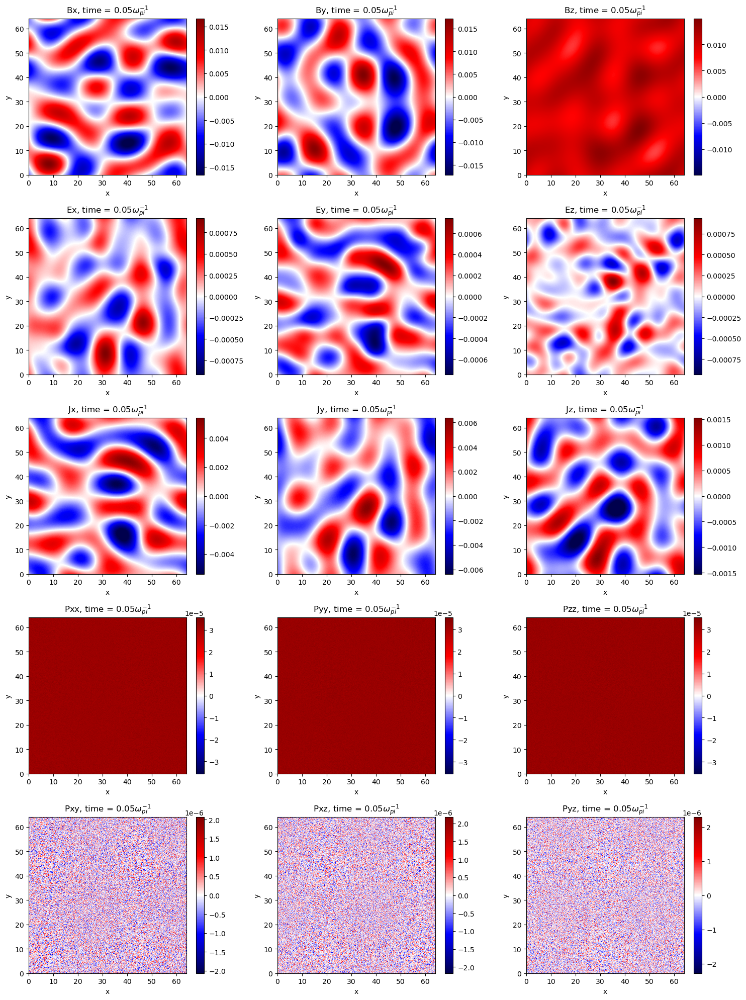

In [5]:
import numpy as  np
i = 0
time = times[i]
fig, axs = plt.subplots(5, 3, figsize=(15, 20))
fields = ['Bx', 'By', 'Bz', 'Ex', 'Ey', 'Ez', 'Jx', 'Jy', 'Jz', 'Pxx','Pyy','Pzz','Pxy','Pxz','Pyz']
for ax, field in zip(axs.flat, fields):
    if field in ['Bx', 'By', 'Bz', 'Ex', 'Ey', 'Ez']:
        im = ax.pcolormesh(X, Y, data[experiment][field][...,i], cmap='seismic', vmax = data[experiment][field][...,i].max(), vmin = -data[experiment][field][...,i].max())
    else:
        im = ax.pcolormesh(X, Y, data[experiment][field]['i'][...,i], cmap='seismic', vmax = data[experiment][field]['i'][...,i].max(), vmin = -data[experiment][field]['i'][...,i].max())
    fig.colorbar(im, ax=ax)
    ax.set_title(f"{field}, time = {time}"+r"$\omega_{pi}^{-1}$")
    ax.set_xlabel('x')
    ax.set_ylabel('y')
plt.tight_layout()
plt.show()

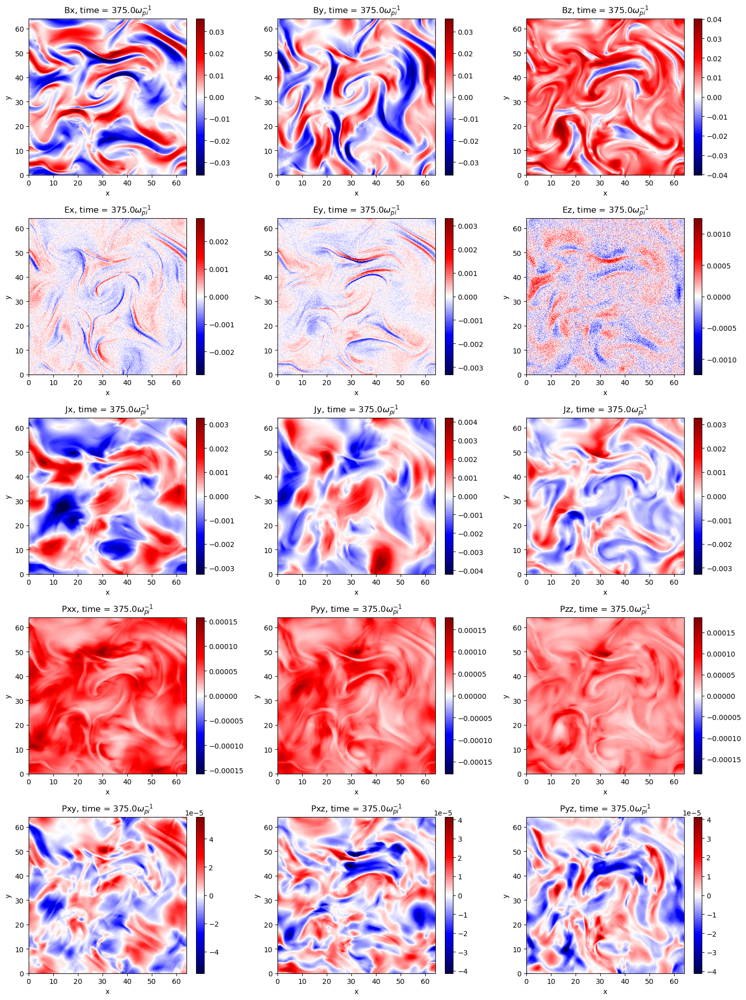

In [26]:
import numpy as  np
i = 15
time = times[i]
fig, axs = plt.subplots(5, 3, figsize=(15, 20))
fields = ['Bx', 'By', 'Bz', 'Ex', 'Ey', 'Ez', 'Jx', 'Jy', 'Jz', 'Pxx','Pyy','Pzz','Pxy','Pxz','Pyz']
for ax, field in zip(axs.flat, fields):
    if field in ['Bx', 'By', 'Bz', 'Ex', 'Ey', 'Ez']:
        im = ax.pcolormesh(X, Y, data[experiment][field][...,i], cmap='seismic', vmax = data[experiment][field][...,i].max(), vmin = -data[experiment][field][...,i].max())
    else:
        im = ax.pcolormesh(X, Y, data[experiment][field]['i'][...,i], cmap='seismic', vmax = data[experiment][field]['i'][...,i].max(), vmin = -data[experiment][field]['i'][...,i].max())
    fig.colorbar(im, ax=ax)
    ax.set_title(f"{field}, time = {time}"+r"$\omega_{pi}^{-1}$")
    ax.set_xlabel('x')
    ax.set_ylabel('y')
plt.tight_layout()
plt.show()

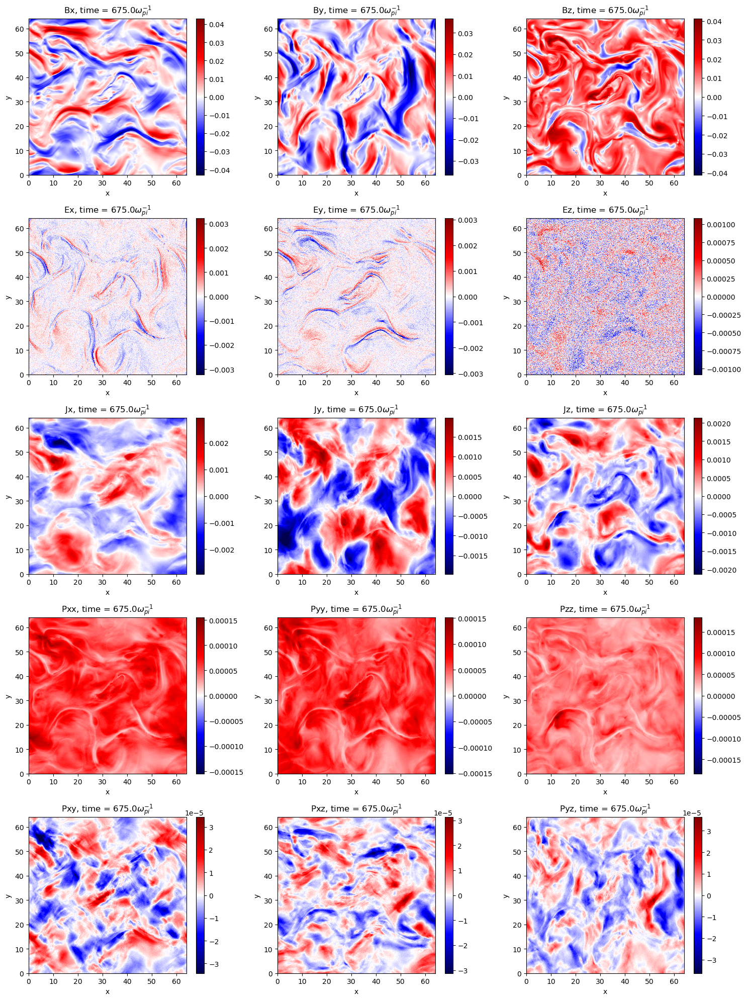

In [19]:
import numpy as  np
i = round(len(times)*650/times[-1])
time = times[i]
fig, axs = plt.subplots(5, 3, figsize=(15, 20))
fields = ['Bx', 'By', 'Bz', 'Ex', 'Ey', 'Ez', 'Jx', 'Jy', 'Jz', 'Pxx','Pyy','Pzz','Pxy','Pxz','Pyz']
for ax, field in zip(axs.flat, fields):
    if field in ['Bx', 'By', 'Bz', 'Ex', 'Ey', 'Ez']:
        im = ax.pcolormesh(X, Y, data[experiment][field][...,i], cmap='seismic', vmax = data[experiment][field][...,i].max(), vmin = -data[experiment][field][...,i].max())
    else:
        im = ax.pcolormesh(X, Y, data[experiment][field]['i'][...,i], cmap='seismic', vmax = data[experiment][field]['i'][...,i].max(), vmin = -data[experiment][field]['i'][...,i].max())
    fig.colorbar(im, ax=ax)
    ax.set_title(f"{field}, time = {time}"+r"$\omega_{pi}^{-1}$")
    ax.set_xlabel('x')
    ax.set_ylabel('y')
plt.tight_layout()
plt.show()

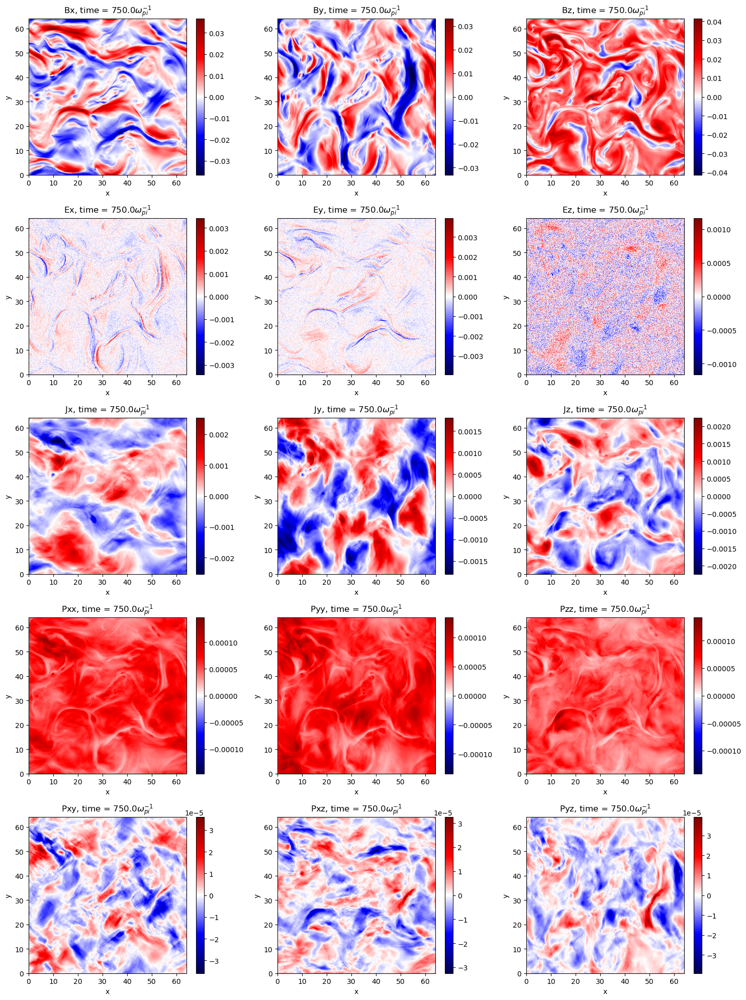

In [27]:
import numpy as  np
i = 30
time = times[i]
fig, axs = plt.subplots(5, 3, figsize=(15, 20))
fields = ['Bx', 'By', 'Bz', 'Ex', 'Ey', 'Ez', 'Jx', 'Jy', 'Jz', 'Pxx','Pyy','Pzz','Pxy','Pxz','Pyz']
for ax, field in zip(axs.flat, fields):
    if field in ['Bx', 'By', 'Bz', 'Ex', 'Ey', 'Ez']:
        im = ax.pcolormesh(X, Y, data[experiment][field][...,i], cmap='seismic', vmax = data[experiment][field][...,i].max(), vmin = -data[experiment][field][...,i].max())
    else:
        im = ax.pcolormesh(X, Y, data[experiment][field]['i'][...,i], cmap='seismic', vmax = data[experiment][field]['i'][...,i].max(), vmin = -data[experiment][field]['i'][...,i].max())
    fig.colorbar(im, ax=ax)
    ax.set_title(f"{field}, time = {time}"+r"$\omega_{pi}^{-1}$")
    ax.set_xlabel('x')
    ax.set_ylabel('y')
plt.tight_layout()
plt.show()

In [8]:
data[experiment]['Vx']['i'].shape, X[:,0].shape

((2048, 2048, 31), (2048,))